In [1]:
import warnings
warnings.filterwarnings("ignore", category=UserWarning)

In [2]:
!pip install -q open_clip_torch torch torchvision

In [3]:
import torch

device = "cuda" if torch.cuda.is_available() else "cpu"
print(f"\nUsing device: {device}")

print(f"\nGPU Available: {torch.cuda.is_available()}")
if torch.cuda.is_available():
    print(f"\nGPU Name: {torch.cuda.get_device_name(0)}")


Using device: cuda

GPU Available: True

GPU Name: Tesla P100-PCIE-16GB


In [4]:
import open_clip

model_name = "ViT-B-32"
print(f"\nLoading CLIP Model: {model_name}")

model, _, preprocess = open_clip.create_model_and_transforms(model_name, pretrained='openai')
tokenizer = open_clip.get_tokenizer(model_name)
model = model.to(device)

print(f"\nModel Loaded Successfully")


Loading CLIP Model: ViT-B-32

Model Loaded Successfully


In [5]:
from torch.utils.data import Dataset, DataLoader
import pandas as pd
from PIL import Image

class ImageTextDataset(Dataset):
    def __init__(self, csv_path, preprocess):
        df = pd.read_csv(csv_path)
        self.images = df['image_path'].tolist()
        self.texts = df['text'].astype(str).tolist()
        self.preprocess = preprocess

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        img = Image.open(self.images[idx]).convert("RGB")
        img = self.preprocess(img)
        txt = self.texts[idx]
        return img, txt

In [6]:
from torchvision.datasets import CocoCaptions
import os
import pandas as pd
from tqdm import tqdm
import kagglehub

path = kagglehub.dataset_download("awsaf49/coco-2017-dataset")
print(f"\nPath to Dataset Files: {path}")

coco2017_path = os.path.join(path, "coco2017")
coco_root = os.path.join(coco2017_path, "train2017")
ann_file = os.path.join(coco2017_path, "annotations/captions_train2017.json")
train_csv_path = "dataset_train.csv"

print()
coco = CocoCaptions(root=coco_root, annFile=ann_file)
print()

if not os.path.exists(train_csv_path):
    image_paths = []
    texts = []

    for idx in tqdm(range(len(coco)), desc="Processing COCO Captions"):
        img, captions = coco[idx]
        img_path = os.path.join(coco_root, coco.coco.imgs[coco.ids[idx]]['file_name'])
        for caption in captions:
            image_paths.append(img_path)
            texts.append(caption)

    df_train = pd.DataFrame({"image_path": image_paths, "text": texts})
    df_train = df_train.sample(frac=1, random_state=501).reset_index(drop=True) 
    df_train.to_csv(train_csv_path, index=False)
    print(f"\nSaved CSV To: {train_csv_path}")
else:
    print(f"\nCSV File Already Exists: {train_csv_path}")
    df_train = pd.read_csv(train_csv_path)


Path to Dataset Files: /kaggle/input/

loading annotations into memory...
Done (t=1.01s)
creating index...
index created!


CSV File Already Exists: dataset_train.csv


In [7]:
print("Dataset Shape: ", df_train.shape)

Dataset Shape:  (591753, 2)


In [8]:
display(df_train.head(10))

,image_path,text
0,/kaggle/input/coco2017/train2017/000000306557.jpg,"A bathroom with a sink, medicine cabinet and m..."
1,/kaggle/input/coco2017/train2017/000000576431.jpg,People on skis are on a ski slope.
2,/kaggle/input/coco2017/train2017/000000227125.jpg,there are three different lights that show if ...
3,/kaggle/input/coco2017/train2017/000000491017.jpg,A group of men in bondage gear standing outside.
4,/kaggle/input/coco2017/train2017/000000009186.jpg,A group of white vases sitting behind a glass ...
5,/kaggle/input/coco2017/train2017/000000059735.jpg,a herd of elephants walking through a marsh land
6,/kaggle/input/coco2017/train2017/000000241832.jpg,A close up of wine glasses filled with red wine.
7,/kaggle/input/coco2017/train2017/000000471351.jpg,Lady in open field flying a kite while others ...
8,/kaggle/input/coco2017/train2017/000000054598.jpg,There is a cake doughnut on a small plate alon...
9,/kaggle/input/coco2017/train2017/000000234615.jpg,A large brown cow with horns standing on a gre...


In [9]:
print(f"\nTotal Images in our Training Set: {len(os.listdir(coco_root))}")
print(f"\nTotal (Image, Text) Pairs in our CSV Train Dataset: {len(pd.read_csv(train_csv_path))}")


Total Images in our Training Set: 118287

Total (Image, Text) Pairs in our CSV Train Dataset: 591753


In [10]:
import random
from tqdm import tqdm
import pandas as pd
from torch.utils.data import DataLoader

def train(train_csv_path, batch_size=64, epochs=3, lr=1e-5, num_workers=4,
          freeze_visual=False, freeze_text=True, updates=5):

    if freeze_visual:
        for p in model.visual.parameters(): p.requires_grad = False
    if freeze_text:
        for p in model.transformer.parameters(): p.requires_grad = False

    dataset = ImageTextDataset(train_csv_path, preprocess)
    loader = DataLoader(dataset, batch_size=batch_size, shuffle=False,
                        num_workers=num_workers, pin_memory=True)
    out_prefix = "clip_ft"

    print(f"\nTotal Batches: {len(loader)} Batches * {batch_size} Units\n")

    optimizer = torch.optim.AdamW([p for p in model.parameters() if p.requires_grad],
                                  lr=lr, weight_decay=1e-4)

    img_to_idx = {}
    for i, path in enumerate(dataset.images):
        if path not in img_to_idx:
            img_to_idx[path] = i
    
    unique_paths = list(img_to_idx.keys())
    unique_indices = list(img_to_idx.values())

    model.train()
    loss_history = {}

    for epoch in range(epochs):
        epoch_path = f"{out_prefix}_ep_{epoch+1}.pth"
        if os.path.exists(epoch_path):
            model.load_state_dict(torch.load(epoch_path, map_location=device))
            print(f"\nSkipping Epoch and Loading Model from Epoch: {epoch+1}")
            continue

        total_loss = 0.0
        if epoch == 0 or epoch % max(1, epochs // updates) == 0:
            H_paths = []
            shuffled = list(range(len(dataset)))
            while True:
                random.shuffle(shuffled)
                if all(h != i for i, h in enumerate(shuffled)):
                    break
            H_paths = [dataset.images[h] for h in shuffled]

        H_indices = [img_to_idx[p] for p in H_paths]

        df = pd.DataFrame({
            "image_path": dataset.images,
            "text": dataset.texts,
            f"hard_neg_epoch_{epoch+1}": H_paths
        })
        df.to_csv(f"hard_negatives_ep_{epoch}.csv", index=False)

        for batch_idx, (imgs, texts) in enumerate(
            tqdm(loader, desc=f"Processing Batches Epoch {epoch+1}/{epochs}", leave=False)
        ):
            imgs, tokens = imgs.to(device), tokenizer(texts).to(device)
            optimizer.zero_grad()
                
            img_feats = model.encode_image(imgs)
            txt_feats = model.encode_text(tokens)
            
            img_feats = img_feats / img_feats.norm(dim=-1, keepdim=True)
            txt_feats = txt_feats / txt_feats.norm(dim=-1, keepdim=True)
            
            batch_H = H_indices[batch_idx*batch_size : batch_idx*batch_size + len(imgs)]
            neg_imgs = torch.stack([dataset[idx][0] for idx in batch_H]).to(device)
            
            neg_img_feats = model.encode_image(neg_imgs)
            neg_img_feats = neg_img_feats / neg_img_feats.norm(dim=-1, keepdim=True)
            
            pos_scores = (img_feats * txt_feats).sum(dim=-1)
            neg_scores = (neg_img_feats * txt_feats).sum(dim=-1)
            loss = -torch.log(torch.sigmoid(pos_scores - neg_scores)).mean()
            
            loss.backward()
            optimizer.step()
            total_loss += loss.item()

        loss_history[epoch+1] = total_loss/len(loader)
        print(f"\nEpoch {epoch+1}/{epochs} | Loss: {total_loss/len(loader):.4f}")
        torch.save(model.state_dict(), epoch_path)
        print(f"\nEpoch Model Saved To: {epoch_path}")

    model_path = f"{out_prefix}_final.pth"
    torch.save(model.state_dict(), model_path)
    print("\nTraining Completed")
    print(f"\nModel Saved To: {model_path}")

    return loss_history

In [11]:
import pandas as pd

csv_path = "dataset_train.csv"
k = 0.05

df = pd.read_csv(csv_path)
subset_len = int(len(df) * k)
df_subset = df.iloc[:subset_len]

train_csv_path = f"dataset_train_{int(k*100)}.csv"
df_subset.to_csv(train_csv_path, index=False)

In [12]:
print("Dataset Shape: ", df_subset.shape)

Dataset Shape:  (29587, 2)


In [13]:
display(df_subset.head(10))

,image_path,text
0,/kaggle/input/coco2017/train2017/000000306557.jpg,"A bathroom with a sink, medicine cabinet and m..."
1,/kaggle/input/coco2017/train2017/000000576431.jpg,People on skis are on a ski slope.
2,/kaggle/input/coco2017/train2017/000000227125.jpg,there are three different lights that show if ...
3,/kaggle/input/coco2017/train2017/000000491017.jpg,A group of men in bondage gear standing outside.
4,/kaggle/input/coco2017/train2017/000000009186.jpg,A group of white vases sitting behind a glass ...
5,/kaggle/input/coco2017/train2017/000000059735.jpg,a herd of elephants walking through a marsh land
6,/kaggle/input/coco2017/train2017/000000241832.jpg,A close up of wine glasses filled with red wine.
7,/kaggle/input/coco2017/train2017/000000471351.jpg,Lady in open field flying a kite while others ...
8,/kaggle/input/coco2017/train2017/000000054598.jpg,There is a cake doughnut on a small plate alon...
9,/kaggle/input/coco2017/train2017/000000234615.jpg,A large brown cow with horns standing on a gre...


In [14]:
train_csv_path = f"dataset_train_{int(k*100)}.csv"
num_epochs = 5
num_updates = num_epochs
loss_history = train(train_csv_path, epochs=num_epochs, updates=num_updates)


Total Batches: 463 Batches * 64 Units




Epoch 1/5 | Loss: 0.4496

Epoch Model Saved To: clip_ft_ep_1.pth



Epoch 2/5 | Loss: 0.3751

Epoch Model Saved To: clip_ft_ep_2.pth



Epoch 3/5 | Loss: 0.3589

Epoch Model Saved To: clip_ft_ep_3.pth



Epoch 4/5 | Loss: 0.3520

Epoch Model Saved To: clip_ft_ep_4.pth



Epoch 5/5 | Loss: 0.3478

Epoch Model Saved To: clip_ft_ep_5.pth

Training Completed

Model Saved To: clip_ft_final.pth



Training Results on 5.00% Train Dataset:

Loss History:  {1: 0.4496237428991635, 2: 0.37514835744130687, 3: 0.35889659928194134, 4: 0.3519505474788839, 5: 0.34779016541610785}


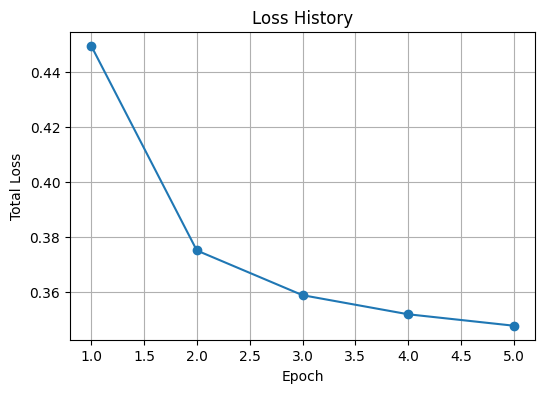

In [15]:
import matplotlib.pyplot as plt

print(f"\nTraining Results on {k*100:.2f}% Train Dataset:")
print("\nLoss History: ", loss_history)

plt.figure(figsize=(6,4))
plt.plot(list(loss_history.keys()), list(loss_history.values()), marker='o')
plt.xlabel("Epoch")
plt.ylabel("Total Loss")
plt.title("Loss History")
plt.grid(True)
plt.show()

In [16]:
from torchvision.datasets import CocoCaptions
import os
import pandas as pd
from tqdm import tqdm
import kagglehub

path = kagglehub.dataset_download("awsaf49/coco-2017-dataset")
print(f"\nPath to Dataset Files: {path}")

coco2017_path = os.path.join(path, "coco2017")
coco_root = os.path.join(coco2017_path, "val2017")
ann_file = os.path.join(coco2017_path, "annotations/captions_val2017.json")
test_csv_path = "dataset_test.csv"

print()
coco = CocoCaptions(root=coco_root, annFile=ann_file)
print()

if not os.path.exists(test_csv_path):
    image_paths = []
    texts = []

    for idx in tqdm(range(len(coco)), desc="Processing COCO Captions"):
        img, captions = coco[idx]
        img_path = os.path.join(coco_root, coco.coco.imgs[coco.ids[idx]]['file_name'])
        for caption in captions:
            image_paths.append(img_path)
            texts.append(caption)

    df_test = pd.DataFrame({"image_path": image_paths, "text": texts})
    df_test = df_test.sample(frac=1, random_state=501).reset_index(drop=True) 
    df_test.to_csv(test_csv_path, index=False)
    print(f"\nSaved CSV To: {test_csv_path}")
else:
    print(f"\nCSV File Already Exists: {test_csv_path}")
    df_test = pd.read_csv(test_csv_path)


Path to Dataset Files: /kaggle/input/

loading annotations into memory...
Done (t=0.08s)
creating index...
index created!



Processing COCO Captions: 100%|██████████| 5000/5000 [01:01<00:00, 81.16it/s]



Saved CSV To: dataset_test.csv


In [17]:
print("Dataset Shape: ", df_test.shape)

Dataset Shape:  (25014, 2)


In [18]:
display(df_test.head(10))

,image_path,text
0,/kaggle/input/coco2017/val2017/000000183246.jpg,A busy intersection with cars waiting for a re...
1,/kaggle/input/coco2017/val2017/000000329080.jpg,A couple of beds sitting next to each other in...
2,/kaggle/input/coco2017/val2017/000000124442.jpg,a man at the beach trying to fly a kite
3,/kaggle/input/coco2017/val2017/000000261796.jpg,A tree stands net to an old wood house
4,/kaggle/input/coco2017/val2017/000000499313.jpg,A white plate topped with a pizza cut into 6 s...
5,/kaggle/input/coco2017/val2017/000000528977.jpg,Graffiti on a building next to street signs.
6,/kaggle/input/coco2017/val2017/000000438226.jpg,a sandwich on a plate on a desk near a glass o...
7,/kaggle/input/coco2017/val2017/000000340451.jpg,a person sitting on a bench wearing some boots...
8,/kaggle/input/coco2017/val2017/000000384661.jpg,a stainless steel stove and oven with a shelf ...
9,/kaggle/input/coco2017/val2017/000000306136.jpg,an apple building and a white bus and people


In [19]:
print(f"\nTotal Images in our Testing Set: {len(os.listdir(coco_root))}")
print(f"\nTotal (Image, Text) Pairs in our CSV Test Dataset: {len(pd.read_csv(test_csv_path))}")


Total Images in our Testing Set: 5000

Total (Image, Text) Pairs in our CSV Test Dataset: 25014


In [20]:
import torch
from torch.utils.data import DataLoader
from tqdm import tqdm
import json
import numpy as np
from datetime import datetime
import open_clip

@torch.no_grad()
def test(test_csv_path, model_path, batch_size=64, top_k=5):
    model, _, preprocess = open_clip.create_model_and_transforms(model_name, pretrained=None)
    tokenizer = open_clip.get_tokenizer(model_name)
    model.load_state_dict(torch.load(model_path, map_location=device))
    model = model.to(device)
    model.eval()
    
    dataset = ImageTextDataset(test_csv_path, preprocess)
    loader = DataLoader(dataset, batch_size=batch_size, shuffle=False, num_workers=4, pin_memory=True)

    img_to_idx, unique_paths = {}, []
    for i, path in enumerate(dataset.images):
        if path not in img_to_idx:
            img_to_idx[path] = i
            unique_paths.append(path)

    unique_img_feats = []
    for b in tqdm(range(0, len(unique_paths), batch_size), desc="Encoding Unique Images"):
        batch_paths = unique_paths[b:b+batch_size]
        batch_imgs = torch.stack([dataset[img_to_idx[p]][0] for p in batch_paths]).to(device)
        feats = model.encode_image(batch_imgs)
        feats /= feats.norm(dim=-1, keepdim=True)
        unique_img_feats.append(feats)
    unique_img_feats = torch.cat(unique_img_feats)
    print("\nUnique Images Features Shape:", unique_img_feats.shape)

    txt_feats = []
    for _, texts in tqdm(loader, desc="Encoding Texts"):
        tokens = tokenizer(list(texts)).to(device)
        feats = model.encode_text(tokens)
        feats /= feats.norm(dim=-1, keepdim=True)
        txt_feats.append(feats)
    txt_feats = torch.cat(txt_feats)
    print("\nTexts Features Shape:", txt_feats.shape)

    logits = model.logit_scale.exp() * (txt_feats @ unique_img_feats.t())

    results, ranks = [], []
    for i, text in enumerate(tqdm(dataset.texts, desc="Processing Queries")):
        scores = logits[i]
        sorted_idx = scores.argsort(descending=True)
        sorted_paths = [unique_paths[j] for j in sorted_idx.tolist()]

        gt_path = dataset.images[i]
        gt_rank = sorted_paths.index(gt_path) + 1
        gt_score = float(scores[sorted_idx[gt_rank-1]])
        ranks.append(gt_rank)

        retrieved = [
            {
                "rank": r+1,
                "path": unique_paths[idx],
                "score": float(scores[idx])
            } for r, idx in enumerate(sorted_idx[:top_k])
        ]

        results.append({
            "query": text,
            "gt_path": gt_path,
            "gt_rank": gt_rank,
            "gt_score": gt_score,
            "retrieved": retrieved
        })

    ranks = np.array(ranks)
    metrics = {"MRR": float(np.mean(1 / ranks)), "Results": results}
    for k_val in range(1, top_k+1):
        metrics[f"Precision@{k_val}"] = float(np.mean(ranks <= k_val))    
        metrics[f"Recall@{k_val}"] = float(np.mean(ranks <= k_val)) 

    timestamp = datetime.now().strftime("%Y%m%d_%H%M%S")
    metrics_path = f"clip_test_metrics_{timestamp}.json"
    with open(metrics_path, "w") as f:
        json.dump(metrics, f, indent=4)

    print(f"\nMetrics Saved To: {metrics_path}")
    return metrics

In [21]:
import pandas as pd

csv_path = "dataset_test.csv"
k = 0.25

df = pd.read_csv(csv_path)
subset_len = int(len(df) * k)
df_subset = df.iloc[:subset_len]

train_csv_path = f"dataset_test_{int(k*100)}.csv"
df_subset.to_csv(train_csv_path, index=False)

In [22]:
print("Dataset Shape: ", df_subset.shape)

Dataset Shape:  (6253, 2)


In [23]:
display(df_subset.head(10))

,image_path,text
0,/kaggle/input/coco2017/val2017/000000183246.jpg,A busy intersection with cars waiting for a re...
1,/kaggle/input/coco2017/val2017/000000329080.jpg,A couple of beds sitting next to each other in...
2,/kaggle/input/coco2017/val2017/000000124442.jpg,a man at the beach trying to fly a kite
3,/kaggle/input/coco2017/val2017/000000261796.jpg,A tree stands net to an old wood house
4,/kaggle/input/coco2017/val2017/000000499313.jpg,A white plate topped with a pizza cut into 6 s...
5,/kaggle/input/coco2017/val2017/000000528977.jpg,Graffiti on a building next to street signs.
6,/kaggle/input/coco2017/val2017/000000438226.jpg,a sandwich on a plate on a desk near a glass o...
7,/kaggle/input/coco2017/val2017/000000340451.jpg,a person sitting on a bench wearing some boots...
8,/kaggle/input/coco2017/val2017/000000384661.jpg,a stainless steel stove and oven with a shelf ...
9,/kaggle/input/coco2017/val2017/000000306136.jpg,an apple building and a white bus and people


In [24]:
test_csv_path = f"dataset_test_{int(k*100)}.csv"
model_path = "clip_ft_final.pth"
metrics = test(test_csv_path, model_path, top_k=10)

Encoding Unique Images: 100%|██████████| 60/60 [00:36<00:00,  1.66it/s]



Unique Images Features Shape: torch.Size([3789, 512])


Encoding Texts: 100%|██████████| 98/98 [00:26<00:00,  3.75it/s]



Texts Features Shape: torch.Size([6253, 512])


Processing Queries: 100%|██████████| 6253/6253 [00:05<00:00, 1223.25it/s]



Metrics Saved To: clip_test_metrics_20251112_132009.json


In [25]:
print(f"\nTest Results on {k*100:.2f}% Test Dataset:")
for metric in metrics:
    if metric != "Results":
        print(f"\t{metric:15}: {metrics[metric]*100:.4f} %" )


Test Results on 25.00% Test Dataset:
	MRR            : 30.8842 %
	Precision@1    : 19.6386 %
	Recall@1       : 19.6386 %
	Precision@2    : 28.3864 %
	Recall@2       : 28.3864 %
	Precision@3    : 34.0636 %
	Recall@3       : 34.0636 %
	Precision@4    : 38.3816 %
	Recall@4       : 38.3816 %
	Precision@5    : 42.0118 %
	Recall@5       : 42.0118 %
	Precision@6    : 44.9704 %
	Recall@6       : 44.9704 %
	Precision@7    : 47.7691 %
	Recall@7       : 47.7691 %
	Precision@8    : 50.1679 %
	Recall@8       : 50.1679 %
	Precision@9    : 52.2149 %
	Recall@9       : 52.2149 %
	Precision@10   : 53.9901 %
	Recall@10      : 53.9901 %



Precision@K Plot:



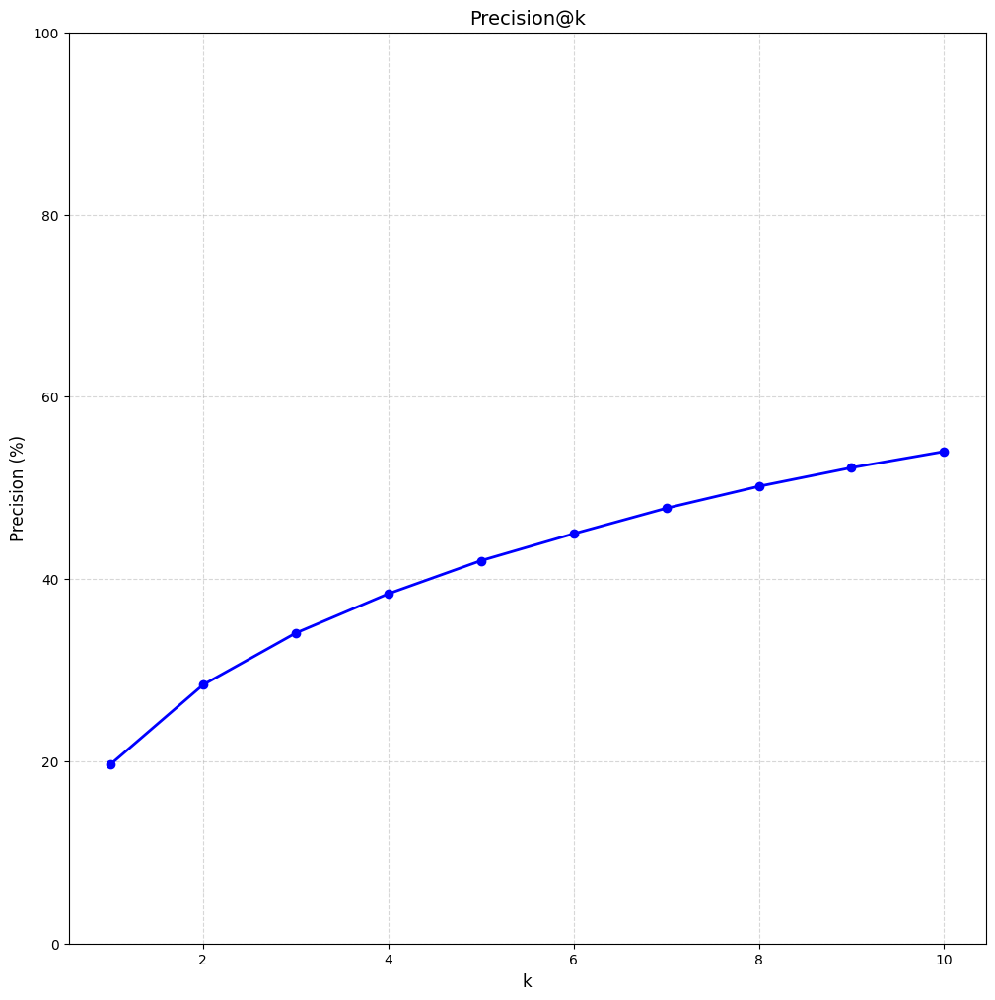

In [26]:
import matplotlib.pyplot as plt

print("\nPrecision@K Plot:\n")
precision_keys = [k for k in metrics if k.lower().startswith("precision@")]
precision_vals = [metrics[k]*100 for k in precision_keys]
ks = [int(k.split("@")[-1]) for k in precision_keys]

plt.figure(figsize=(12,12))  
plt.plot(ks, precision_vals, marker='o', color='blue', linewidth=2)
plt.xlabel("k", fontsize=12)
plt.ylabel("Precision (%)", fontsize=12)
plt.title("Precision@k", fontsize=14)
plt.ylim(0, 100)
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()


Recall@K Plot:



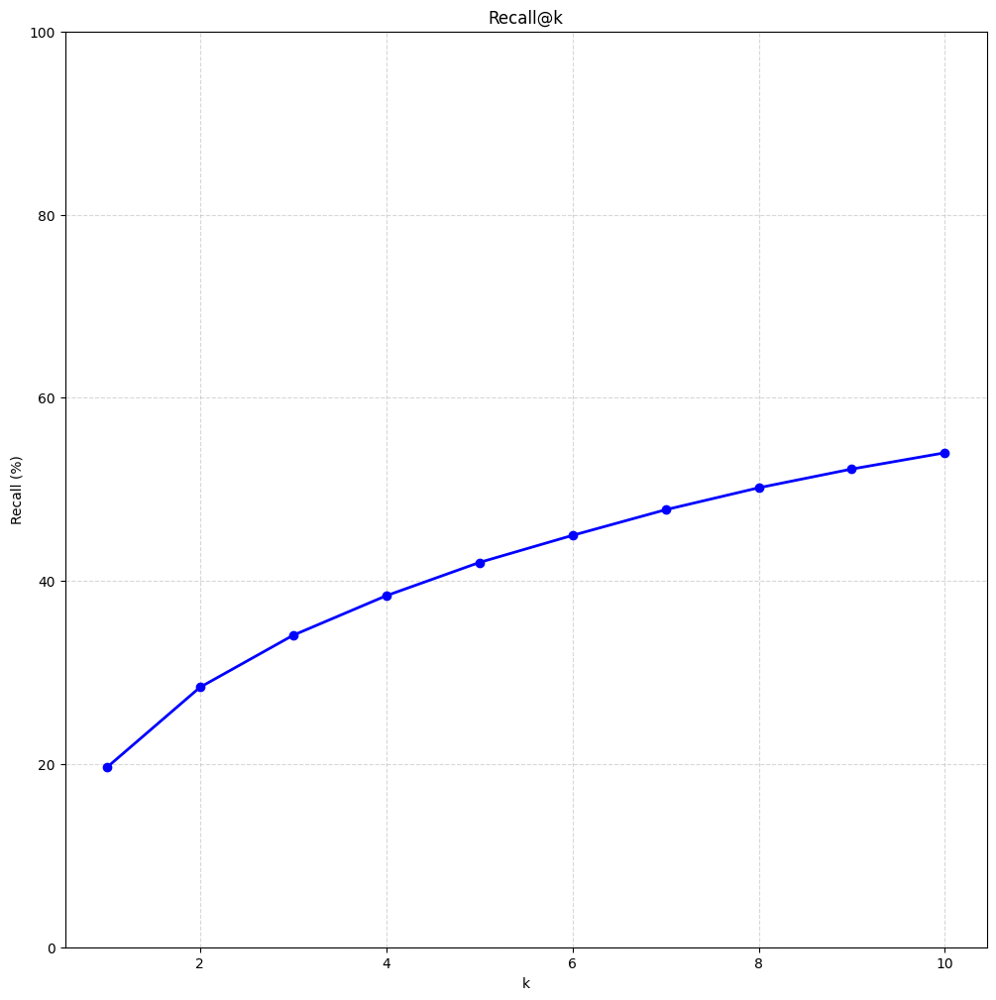

In [27]:
import matplotlib.pyplot as plt

print("\nRecall@K Plot:\n")
recall_keys = [k for k in metrics if k.lower().startswith("recall@")]
recall_vals = [metrics[k]*100 for k in recall_keys]
ks = [int(k.split("@")[-1]) for k in recall_keys]

plt.figure(figsize=(12,12))
plt.plot(ks, recall_vals, marker='o', color='blue', linewidth=2)
plt.xlabel("k")
plt.ylabel("Recall (%)")
plt.title("Recall@k")
plt.ylim(0, 100)
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()

In [28]:
import matplotlib.pyplot as plt
from PIL import Image
import random

def display_query_results(metrics, num_queries=10):
    results = metrics["Results"]
    indices = list(range(len(results)))
    random.shuffle(indices)
    
    for idx in indices[:num_queries]:
        query_data = results[idx]
        query_text = query_data["query"]
        gt_path = query_data["gt_path"]
        gt_rank = query_data.get("gt_rank", None)
        gt_score = query_data.get("gt_score", None)
        retrieved = query_data["retrieved"]
        
        total_cols = 1 + len(retrieved)
        plt.figure(figsize=(3*total_cols, 5))
        plt.suptitle(f"Query: {query_text}", fontsize=12)
        
        plt.subplot(1, total_cols, 1)
        plt.imshow(Image.open(gt_path).convert("RGB"))
        plt.title(f"Ground Truth\nRank: {gt_rank}\nScore: {gt_score:.2f}")
        plt.axis('off')
        
        for j, r in enumerate(retrieved):
            plt.subplot(1, total_cols, j+2)
            plt.imshow(Image.open(r["path"]).convert("RGB"))
            plt.title(f"Rank: {r['rank']}\nScore: {r['score']:.2f}")
            plt.axis('off')
        
        plt.show()

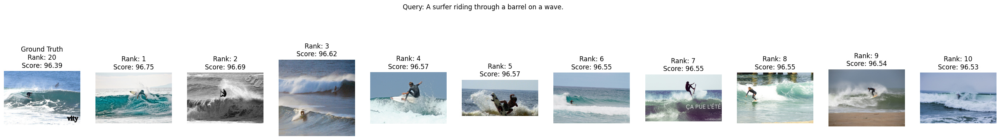

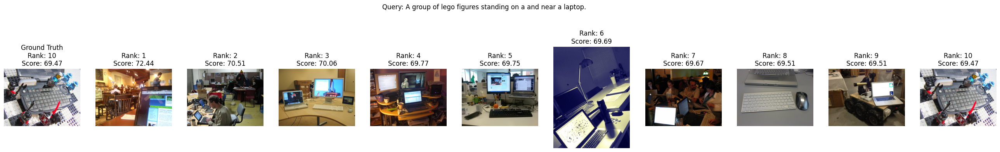

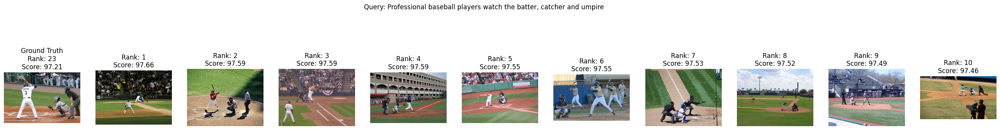

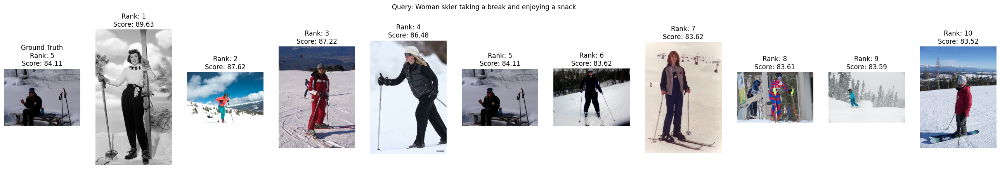

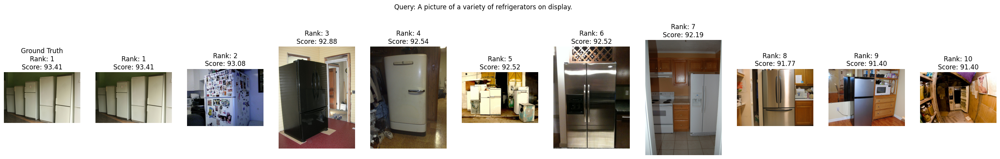

...

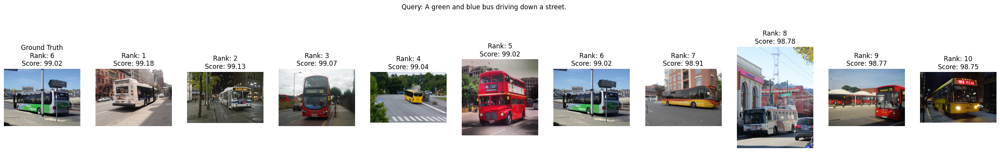

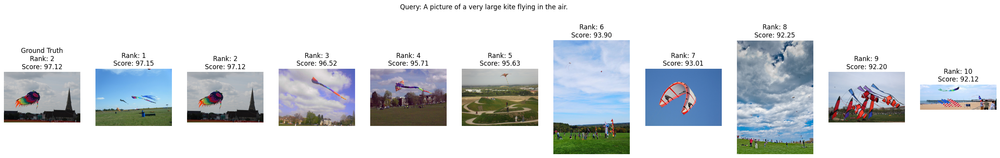

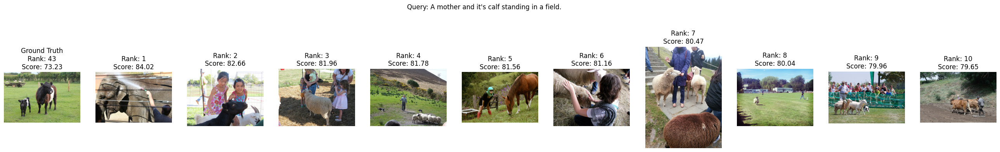

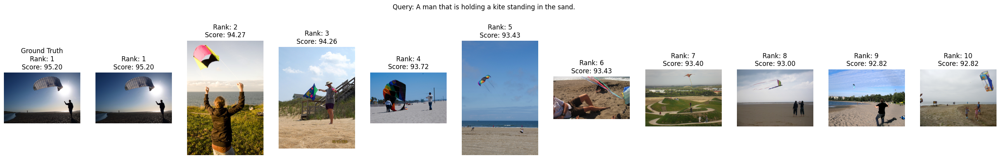

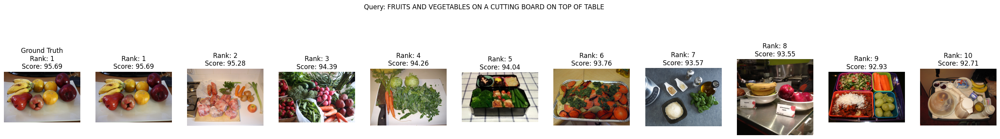

In [29]:
display_query_results(metrics, 25)

In [30]:
# import os

# dir_path = "/kaggle/working/"

# for root, _, files in os.walk(dir_path):
#     for f in files:
#         file_path = os.path.join(root, f)
#         answer = input(f"\nRemove {file_path}? (y/n): ").strip().lower()
#         if answer == '1':
#             os.remove(file_path)
#             print(f"\tRemoved: {file_path}")
#         else:
#             print(f"\tKept: {file_path}")